# Cognitive Computing HW1 
### Tianxin Huang (th29885)

## Problem 4

4. Explain what is a residual network, and the basic motivation for using it. Also explain what are the main elements of resnet34 and resnet50. How many layers, how many neurons total, how many weights; and then anything else you want to say.


In [11]:
import torchvision
import torchsummary
from torchvision import models
from torchsummary import summary
from torchvision import models

In [12]:
summary(models.resnet34(), input_size = (3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1, 64,

In [13]:
summary(models.resnet50(), input_size = (3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]          16,384
      BatchNorm2d-12          [-1, 256, 56, 56]             512
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

Answer:
    
A residual neural network is an artificial neural network that utilizes skip connections or short-cuts to jump over some layers. 

The basix motivation for using it-- skipping over layers can avoid the problem of vanishing gradients by reusing activations from a previous layer until the layer next to the current one learns its weights. 

The main element of ResNet34 and ResNet50 include convolutional layer, batch normalization layer and maxpooling layer. 

According to the summary statistics above--ResNet34 has 124 layers, 21,797,672 weights. ResNet50 has 174 layers, 25,557,032 weights.

Number of neurons is calculated by multiplying the last two number in output shape. Ex., output shape is [-1, 512, 7, 7] , number of neurons is 7 x 7 = 49.

## Problem 5

5. Transfer learning using Fast.ai and create cnn: Please explain how pretrained resnet34 is modified to get the network that the notebook ultimately trains (i.e., explain what are the last layers that are added).

Answer:

Using pretrained ResNet34 means that only the top layers (a.k.a fully connected layers) are trained while the bottom layers are freezed during the training process. Pretrained ResNet34 reuses the weights of a network already trained on the ImageNet dataset to train a new model more quickly. The pre-trained weights trained by ImageNet are good enough to capture the patterns and concepts of the images. 

Therefore, when using pre-trained ResNet34 to train new categories, the bottom layers stay unchanged because they represent basic elements in normal images. This makes training a lot easier.

The last layers added are softmax layers, the final output layers that perform multi-class classification, using softmax function to calculate the posterior probability.



## Problem 6

6. Download a NOT pre-trained resnet34, and then by playing with the number of epochs and learning rates (possibly different learning rates across layers), see how low you can get the error. Can you get below 20%?

In [34]:
learn10 = create_cnn(data, models.resnet34, metrics=error_rate, pretrained=False)
learn10.fit_one_cycle(80)

epoch,train_loss,valid_loss,error_rate
1,4.056545,3.630543,0.952528
2,3.973528,3.568042,0.942208
3,3.886120,3.494400,0.919505
4,3.827003,3.467771,0.931889
5,3.764698,3.411618,0.914345
6,3.684624,3.364495,0.913313
7,3.633096,3.325620,0.898865
8,3.570601,3.275699,0.878225
9,3.500774,3.221737,0.857585
10,3.440326,3.159937,0.853457


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


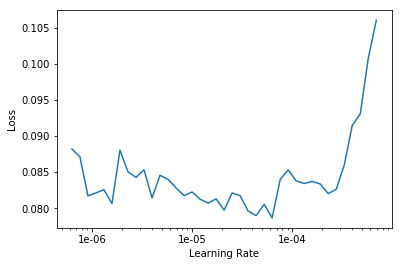

In [35]:
learn10.lr_find()
learn10.recorder.plot()

In [36]:
learn10.unfreeze()
learn10.fit_one_cycle(10, max_lr=slice(1e-5,1e-4))

epoch,train_loss,valid_loss,error_rate
1,0.089600,1.081636,0.256966
2,0.084913,1.082306,0.253870
3,0.079089,1.094282,0.251806
4,0.087491,1.086579,0.249742
5,0.088503,1.126861,0.259030
6,0.087549,1.087911,0.250774
7,0.087181,1.081520,0.256966
8,0.070337,1.075405,0.247678
9,0.074320,1.069876,0.246646
10,0.072498,1.079156,0.251806


I have tried over 10 times playing with different number of epochs and different learning rates. The error rate varies from 0.23 to 0.25 time to time.

## Problem 7  Build a classifier

I used google-image-download to create a dataset including 7 artists' paintings (around 100 paintings per artists including Cezanne, Dali, Durer, Monet, Picasso, Rembrandt and Van Gogh).

I ran the following commands in virtual terminal.

In [14]:
#googleimagesdownload -k "van gogh painting" -l 100
#googleimagesdownload -k "monet" -l 100
#googleimagesdownload -k "Durer" -l 100
#googleimagesdownload -k "Dali" -l 100
#googleimagesdownload -k "Cezanne" -l 100
#googleimagesdownload -k "Picasso" -l 100
#googleimagesdownload -k "Rembrandt" -l 100

In [4]:
import os
import re

I renamed every image to include artists' names.

In [13]:
path_read = '/notebooks/downloads/van gogh/'
files = os. listdir(path_read)
cursor = 1
for pic in files:
    os.rename(path_read + pic, path_read + 'vangogh' + str(cursor) + '.jpg')
    cursor += 1

In [258]:
path_read2 = '/notebooks/downloads/Dali/'
files2 = os. listdir(path_read2)
cursor2 = 1
for pic in files2:
    os.rename(path_read2 + pic, path_read2 + 'dali' + str(cursor2) + '.jpg')
    cursor2 += 1

In [259]:
path_read3 = '/notebooks/downloads/Cezanne/'
files3 = os. listdir(path_read3)
cursor3 = 1
for pic in files3:
    os.rename(path_read3 + pic, path_read3 + 'cezanne' + str(cursor3) + '.jpg')
    cursor3 += 1

In [113]:
path_read = '/notebooks/downloads/paintings/Durer/'
files = os. listdir(path_read)
cursor = 1
for pic in files:
    os.rename(path_read + pic, path_read + 'durer' + str(cursor) + '.jpg')
    cursor += 1

In [21]:
path_read = '/notebooks/downloads/monet/'
files = os. listdir(path_read)
cursor = 1
for pic in files:
    suffix = re.search(r'\.[a-z]+', pic).group()
    os.rename(path_read + pic, path_read + 'monet' + str(cursor) + suffix)
    cursor += 1

In [115]:
path_read = '/notebooks/downloads/paintings/Picasso/'
files = os. listdir(path_read)
cursor = 1
for pic in files:
    os.rename(path_read + pic, path_read + 'picasso' + str(cursor) + '.jpg')
    cursor += 1

In [116]:
path_read = '/notebooks/downloads/paintings/Rembrandt/'
files = os. listdir(path_read)
cursor = 1
for pic in files:
    os.rename(path_read + pic, path_read + 'rembrandt' + str(cursor) + '.jpg')
    cursor += 1

Then I used a for-loop to read 7 folders of images.

In [49]:
path_img = '/notebooks/downloads/classifier/'
files2 = os.listdir(path_img)
fnames = []
for file in files2:
    fnames = fnames + get_image_files(path_img + file)
len(fnames)

645

In [23]:
fnames[:5]

[PosixPath('/notebooks/downloads/classifier/Picasso/picasso56.jpg'),
 PosixPath('/notebooks/downloads/classifier/Picasso/picasso93.jpg'),
 PosixPath('/notebooks/downloads/classifier/Picasso/picasso64.jpg'),
 PosixPath('/notebooks/downloads/classifier/Picasso/picasso20.jpg'),
 PosixPath('/notebooks/downloads/classifier/Picasso/picasso60.jpg')]

In [24]:
np.random.seed(2)
pat = re.compile(r'/([A-Za-z]+)\d+')

In [50]:
data = ImageDataBunch.from_name_re(path_img, fnames, pat, ds_tfms=get_transforms(), size=224, bs=bs
                                  ).normalize(imagenet_stats)

/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (101352316 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)


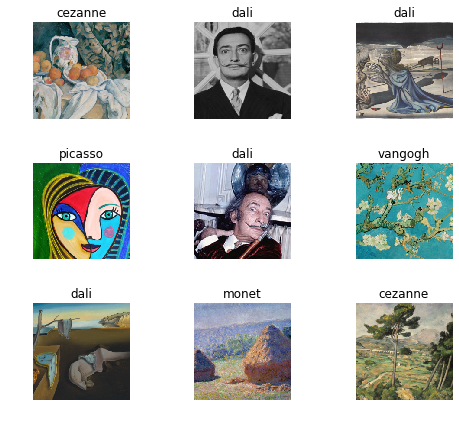

In [26]:
data.show_batch(rows=3, figsize=(7,6))

In [27]:
print(data.classes)
len(data.classes),data.c

['cezanne', 'dali', 'durer', 'monet', 'picasso', 'rembrandt', 'vangogh']


(7, 7)

### Training: resnet34

In [51]:
learn = create_cnn(data, models.resnet34, metrics=error_rate)

In [29]:
learn.model

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (rel

In [52]:
learn.fit_one_cycle(4)

epoch,train_loss,valid_loss,error_rate
1,2.136025,1.116152,0.348837
2,1.367974,0.529772,0.170543
3,0.996522,0.411708,0.100775
4,0.793505,0.404235,0.124031


/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (101352316 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (163328704 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
Exception ignored in: <bound method _DataLoaderIter.__del__ of <torch.utils.data.dataloader._DataLoaderIter object at 0x7fe777873b38>>
Exception ignored in: <bound method _DataLoaderIter.__del__ of <torch.utils.data.dataloader._DataLoaderIter object at 0x7fe777873b38>>
Traceback (most recent call last):
Traceback (most recent call last):
  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 717, in __del__
  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py",

    assert self._parent_pid == os.getpid(), 'can only join a child process'
AssertionError: can only join a child process
AssertionError: can only join a child process
Exception ignored in: <bound method _DataLoaderIter.__del__ of <torch.utils.data.dataloader._DataLoaderIter object at 0x7fe777873b38>>
Traceback (most recent call last):
  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 717, in __del__
    self._shutdown_workers()
  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 713, in _shutdown_workers
    w.join()
  File "/opt/conda/envs/fastai/lib/python3.6/multiprocessing/process.py", line 122, in join
    assert self._parent_pid == os.getpid(), 'can only join a child process'
AssertionError: can only join a child process
Exception ignored in: <bound method _DataLoaderIter.__del__ of <torch.utils.data.dataloader._DataLoaderIter object at 0x7fe777873b38>>
Traceback (most recent call last):


  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 713, in _shutdown_workers
    w.join()
  File "/opt/conda/envs/fastai/lib/python3.6/multiprocessing/process.py", line 122, in join
    assert self._parent_pid == os.getpid(), 'can only join a child process'
AssertionError: can only join a child process
Exception ignored in: <bound method _DataLoaderIter.__del__ of <torch.utils.data.dataloader._DataLoaderIter object at 0x7fe777873b38>>
Traceback (most recent call last):
  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 717, in __del__
    self._shutdown_workers()
  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 713, in _shutdown_workers
    w.join()
  File "/opt/conda/envs/fastai/lib/python3.6/multiprocessing/process.py", line 122, in join
    assert self._parent_pid == os.getpid(), 'can only join a child process'
AssertionError: can only join a ch

  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 713, in _shutdown_workers
    w.join()
  File "/opt/conda/envs/fastai/lib/python3.6/multiprocessing/process.py", line 122, in join
    assert self._parent_pid == os.getpid(), 'can only join a child process'
AssertionError: can only join a child process
Exception ignored in: <bound method _DataLoaderIter.__del__ of <torch.utils.data.dataloader._DataLoaderIter object at 0x7fe777873b38>>
Traceback (most recent call last):
  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 717, in __del__
    self._shutdown_workers()
  File "/opt/conda/envs/fastai/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 713, in _shutdown_workers
    w.join()
  File "/opt/conda/envs/fastai/lib/python3.6/multiprocessing/process.py", line 122, in join
    assert self._parent_pid == os.getpid(), 'can only join a child process'
AssertionError: can only join a ch

In [54]:
learn.save('stage-1')

### Results

In [56]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

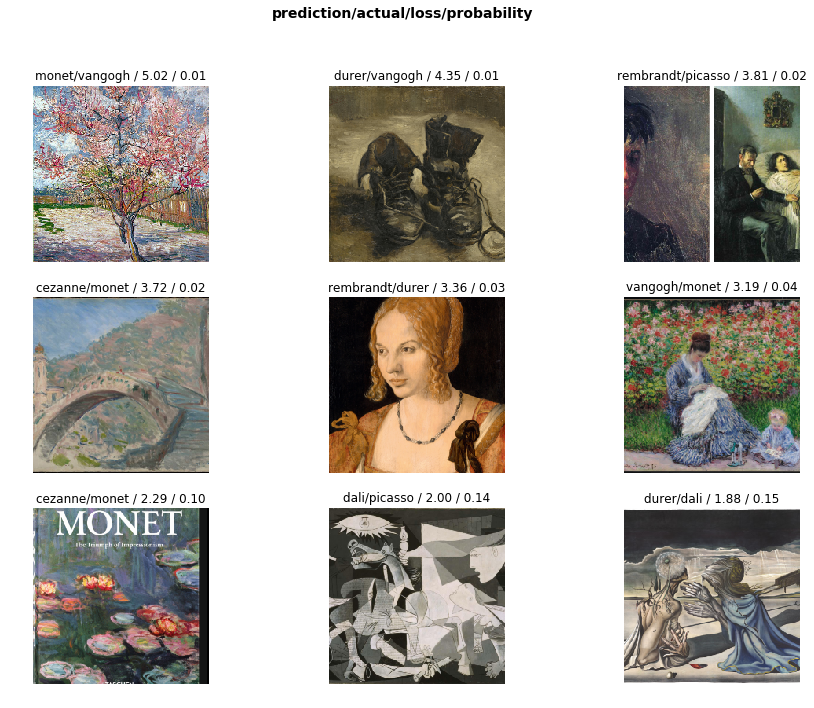

In [85]:
interp.plot_top_losses(9, figsize=(15,11))

In [82]:
doc(interp.plot_top_losses)

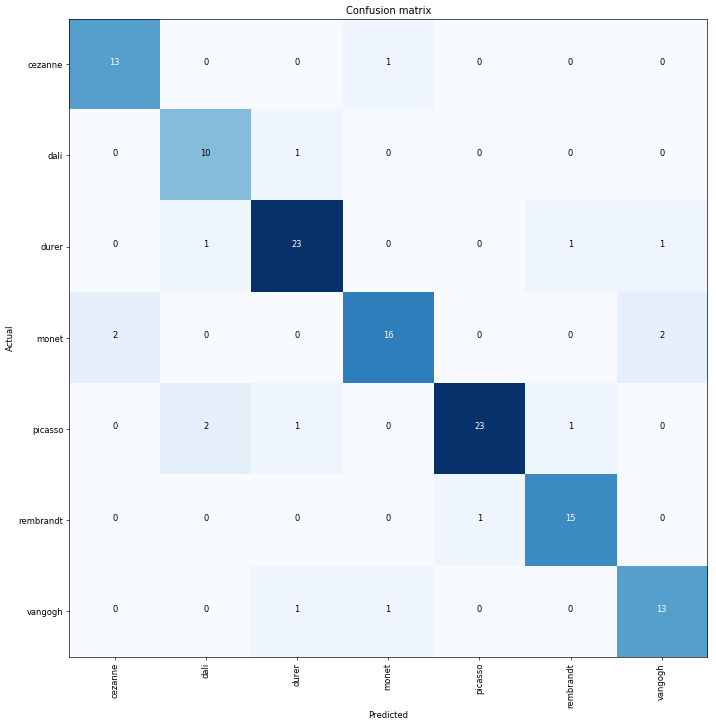

In [83]:
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)

In [87]:
interp.most_confused()

[('monet', 'cezanne', 2), ('monet', 'vangogh', 2), ('picasso', 'dali', 2)]

### Unfreezing, fine-tuning, and learning rates


In [88]:
learn.unfreeze()

In [89]:
learn.fit_one_cycle(1)

epoch,train_loss,valid_loss,error_rate
1,0.394682,0.562551,0.170543


/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (163328704 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (101352316 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)


In [90]:
learn.load('stage-1');

In [91]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


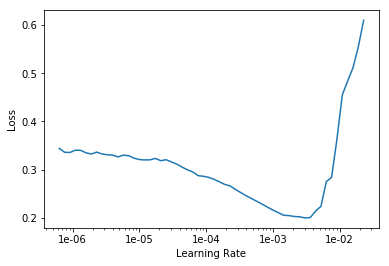

In [92]:
learn.recorder.plot()

In [113]:
learn.unfreeze()
learn.fit_one_cycle(5, max_lr=slice(1e-4,1e-3))

epoch,train_loss,valid_loss,error_rate
1,0.100504,0.370431,0.077519
2,0.134235,0.460950,0.131783
3,0.176719,0.468623,0.147287
4,0.187360,0.372870,0.093023
5,0.151633,0.302346,0.077519


/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (101352316 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (163328704 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (101352316 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (163328704 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombW

The model is pretty accurate!

### Training: resnet50

In [106]:
data = ImageDataBunch.from_name_re(path_img, fnames, pat, ds_tfms=get_transforms(),
                                   size=299, bs=bs//2).normalize(imagenet_stats)

In [107]:
learn = create_cnn(data, models.resnet50, metrics=error_rate)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.torch/models/resnet50-19c8e357.pth
100%|██████████| 102502400/102502400 [00:02<00:00, 48684508.67it/s]


In [109]:
learn.fit_one_cycle(8)

epoch,train_loss,valid_loss,error_rate
1,1.530996,0.611331,0.193798
2,0.891055,0.356511,0.124031
3,0.610084,0.302471,0.085271
4,0.446745,0.295163,0.085271
5,0.339774,0.270981,0.085271
6,0.266592,0.269017,0.085271
7,0.207799,0.262172,0.069767
8,0.170429,0.272044,0.069767


/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (101352316 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (163328704 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (101352316 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombWarning: Image size (163328704 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/opt/conda/envs/fastai/lib/python3.6/site-packages/PIL/Image.py:2600: DecompressionBombW

It gets even more accurate using ResNet50!

In [112]:
learn.save('stage-1-50')

In [114]:
interp = ClassificationInterpretation.from_learner(learn)

In [116]:
interp.most_confused()

[('cezanne', 'picasso', 2)]

### Putting my model into real prediction

In [117]:
learn.export()

In [118]:
defaults.device = torch.device('cpu')

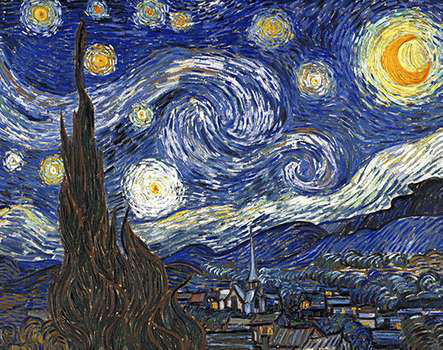

In [123]:
img = open_image('/notebooks/downloads/''van gogh.jpg')
img

In [133]:
path = '/notebooks/downloads/classifier'
learn = load_learner(path)

In [134]:
pred_class,pred_idx,outputs = learn.predict(img)
pred_class

Category vangogh

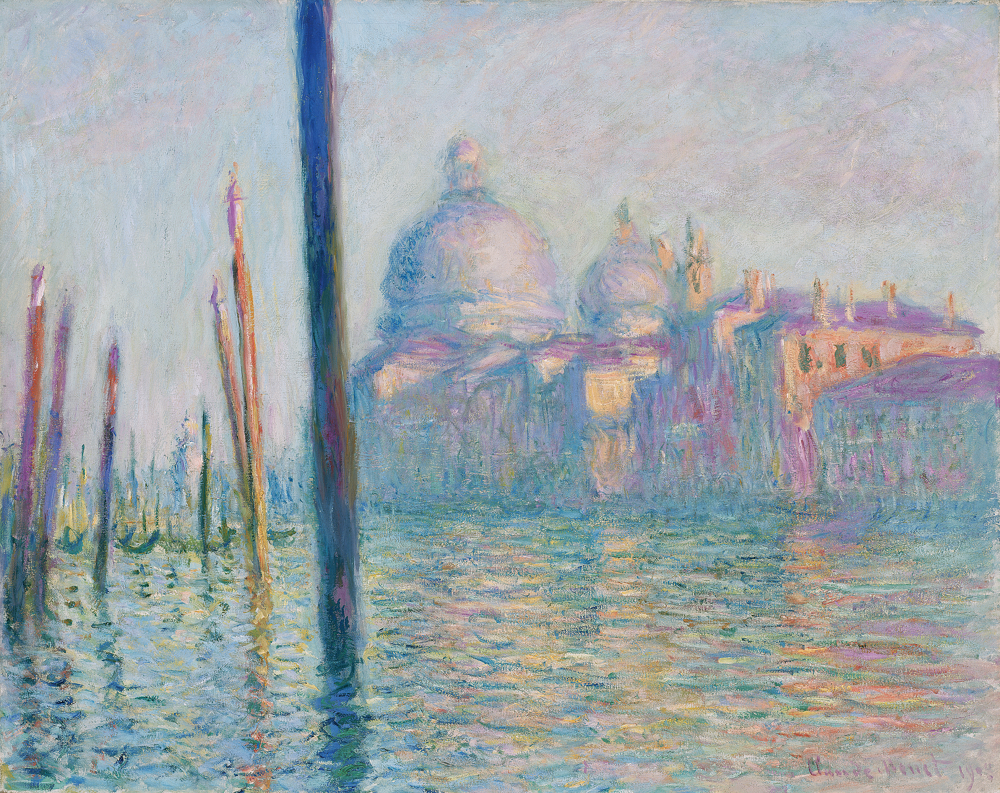

In [135]:
img2 = open_image('/notebooks/downloads/''Claude_Monet,_Le_Grand_Canal.jpg')
img2

In [136]:
pred_class,pred_idx,outputs = learn.predict(img2)
pred_class

Category monet

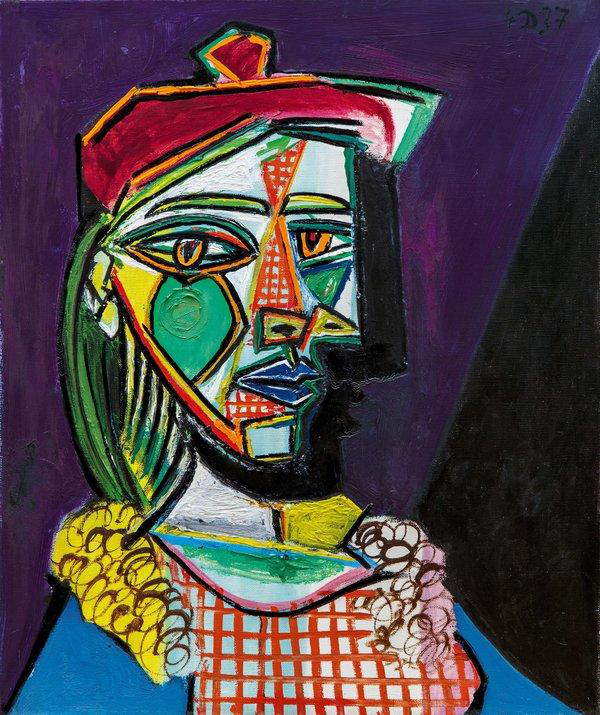

In [137]:
img3 = open_image('/notebooks/downloads/''01picasso1-articleLarge.jpg')
img3


In [138]:
pred_class,pred_idx,outputs = learn.predict(img3)
pred_class

Category picasso

The predictions so far are all correct!